In [1]:
#%reset
# import packages
import pandas as pd
pd.set_option("display.precision", 2)
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import seaborn as sns
import numpy as np
from scipy.stats import norm
from sklearn.preprocessing import StandardScaler
from scipy import stats
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
import os
sns.set()
import re
warnings.filterwarnings('ignore')
from pylab import *
sns.set()
# pip3 install -U scikit-learn scipy matplotlib
def jitter(values,j):
    return values + np.random.normal(j,0.01,values.shape)
from PIL import Image, ImageDraw

In [ ]:
# read data preprocessed in knime
df = pd.read_csv('../data/daint-data/data_20220901_toxclass.csv', encoding ='utf8' , engine='python')
df['model'] = df['model'].str.replace(" ", "")
df['fps'] = df['fps'].str.replace("RDkit", "RDKit")
df['fps_class'] = df['fps_class'].str.replace("RDkit", "RDKit")
df = df.drop(df[df['model'] == "NaiveBayes"].index)
df.rename(columns = {'sample':'subsampling', 'resample':'resampling'}, inplace = True)
vals_to_replace = {'rf':'tree', 'CSimca' :'simca', 'kernelpls':'pls', 'kknn':'knn', 'RRF':'tree', 'RandomForest':'tree', 
          'DecisionTree':'tree', 'adaboost':'boost-tree', 'AdaBag':'boost-tree', 'bayesglm':'linear', 'GeneralizedLinearModel(H2O)':'linear',
          'glmStepAIC':'linear', 'LogisticRegression':'linear', 'regLogistic':'linear', 'deepboost':'boost-tree', 'GradientBoostedTrees':'boost-tree',
          'XGBoostTrees':'xboost-tree', 'xgbTree':'xboost-tree', 'DeepLearning(Keras)':'deep', 'NeuralNetwork':'deep', 'pcaNNet':'deep',
          'glmnet':'deep', 'nnet':'deep', 'avNNet':'deep', 'svmPoly':'svm', 'gaussprRadial':'svm','svmRadialCost':'svm','svmRadialCost':'gaussian', 'gbm':'boost-tree'}
df['model'] = df['model'].map(vals_to_replace)

# add class info
df_class = pd.read_csv('../data/tox21-data/class_endpoint_mechtarget_reftable.csv', encoding ='utf8' , engine='python')
df_class.rename(columns = {'class_id':'class'}, inplace = True)
df_class['class'] = df_class['class'].str.replace("_", "")
df_class = df_class[['mechanisticTargets', 'mechT', 'class']]
df = pd.merge(df, df_class, on='class')
#df['mechT'] = df['mechT'].str.replace(" ", "")

df['mechT'] = df['mechT'].str.replace("GER Steroid Hormone Nuclear Rec.", "Steroid Hormone Rec.")
df['mechT'] = df['mechT'].str.replace("Gamma-Aminobutyric Acid Sign. Path.", "Aminobutyric Acid Path.")
df['mechT'] = df['mechT'].str.replace("CC-GER Fatty Acid Signaling", "Fatty Acid Signaling")
df['mechT'] = df['mechT'].str.replace("GER Developmental Sign.", "GER Dev. Sign.")
df['mechT'] = df['mechT'].str.replace("GER Glucocorticoid Met. Proc.", "Glucocorticoid Met. Proc.")

# create groups of data
df_daint = df[df['source'] == "daint"]
df_knime_oob= df[df['source'] == "knime-oob"]
df_knime_fb= df[df['source'] == "knime-fb"]
frames = [df_daint, df_knime_oob]
dff = pd.concat(frames)
dff.to_csv('../outputs/data_20220901_daint-knimeoob')
df_cytotox = df[df['cyto'] == 'yes']
df_nocytotox = df[df['cyto'] == "no"]
df_xboost = dff[dff['model'] == "xboost-tree"]
df_csi = dff[dff['fps_class'] == "CSI"]
dff.columns

# select winning configuration
df_wc = df.drop(df[df['sampling_independent'] == "no"].index)
df_wc = df_wc[df_wc['model'] == 'xboost-tree']
df_wc = df_wc[df_wc['subsampling'] == 'smote']
df_wc = df_wc[df_wc['resampling'] == 'repeatedcv']
df_wc = df_wc[df_wc['fps'] == 'CSI']
print(df_wc["class"].nunique())
print(df_wc["mechT"].nunique())
print(df_wc.shape)
df_wc_mechT_max = df_wc.groupby('mechT', as_index=False).max(['sensitivity', 'specificity', 'precision', 'F', 'cohen', 'accuracy'])
df_wc_mechT_cyto_mean = df_wc.groupby(['mechT','cyto'], as_index=False).mean() 
df_wc_mechT_cyto_max = df_wc.groupby(['mechT','cyto'], as_index=False).max()
df_wc_mechT_cyto_mean["metric"] = "mean"
df_wc_mechT_cyto_max["metric"] = "max"
frames2 = [df_wc_mechT_cyto_max, df_wc_mechT_cyto_mean]
df_wc_mechT_2 = pd.concat(frames2)
df_wc_mechT_2.groupby("mechT").count()
df_wc_mechT_2.head(5)
# create groupings
dff_mechT_mean = dff.groupby(['mechT','fps_class','model', 'cyto'], as_index=False).mean()
dff_mechT_max = dff.groupby(['mechT','fps_class','model', 'cyto'], as_index=False).max()
dff_assay_max = dff.groupby(['mechT','class'], as_index=False).max()
dff_assay_mean = dff.groupby(['mechT','class'], as_index=False).mean()
dff_assay_max.shape

In [14]:
print(df_wc["mechT"].nunique())
print (df_wc.groupby('cyto')['class'].nunique())

33
cyto
no     169
yes    103
Name: class, dtype: int64


,mechT,cyto,sensitivity,specificity,precision,F,class,fps,model,subsampling,resampling,source,sampling_independent,accuracy,cohen,fps_class,mechanisticTargets,metric
0,Androgen Met. Proc.,no,0.96,0.99,0.99,0.98,class894,CSI,xboost-tree,smote,repeatedcv,knime-oob,yes,0.98,0.95,CSI,"Androgen Metabolic Process,Gene Expression Reg...",max
1,Androgen Met. Proc.,yes,0.98,1.00,1.00,0.99,class894,CSI,xboost-tree,smote,repeatedcv,knime-oob,yes,0.99,0.97,CSI,"Androgen Metabolic Process,Gene Expression Reg...",max
2,Angiogenic Proc.,no,0.74,1.00,0.85,0.79,class530,CSI,xboost-tree,smote,repeatedcv,knime-oob,yes,0.80,0.61,CSI,"Angiogenic Process,Inflammatory Response",max
3,Angiogenic Proc.,yes,0.87,0.97,0.97,0.91,class508,CSI,xboost-tree,smote,repeatedcv,knime-oob,yes,0.91,0.82,CSI,"Angiogenic Process,Inflammatory Response",max
4,Aromatase Act.,no,0.88,0.98,0.98,0.93,class640,CSI,xboost-tree,smote,repeatedcv,knime-oob,yes,0.93,0.86,CSI,Aromatase Activity,max


In [25]:
df['fps'].unique()
df.columns
df_cdk = df[df['fps_class'] == "CDK"]
df_cdk.shape
dff_mechT_mean.head(3)

,mechT,fps_class,model,cyto,sensitivity,specificity,precision,F,accuracy,cohen
0,ACh Rec. Sign. Path.,CDK,deep,yes,0.21,0.71,0.24,0.83,0.46,-0.08
1,ACh Rec. Sign. Path.,CDK,linear,yes,0.41,0.84,0.41,0.71,0.62,0.25
2,ACh Rec. Sign. Path.,CDK,tree,yes,0.78,0.88,0.86,0.81,0.83,0.66


In [ ]:
print(df['model'].unique())
print(df['subsampling'].unique())
print(df['resampling'].unique())
print(df['fps'].unique())
print(df['fps_class'].unique())
print(df['class'].unique())
print(df.columns)
print(df.size)
print(df.info)
print(df.shape)
print(df.head)
print(df.dtypes)
df_daint.describe()
print(df['model'].unique())

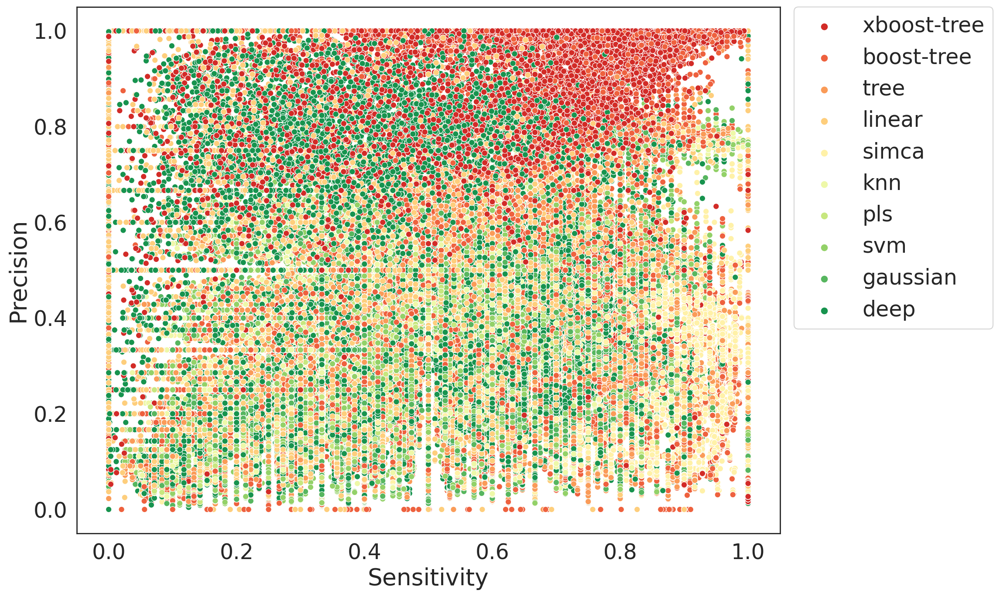

In [10]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      'font.size' : 22}
plt.rcParams.update(rc)
plt.figure(figsize=(13,10), dpi= 80)
sns.set_style("white")
hue_order =['xboost-tree','boost-tree','tree', 'linear', 'simca', 'knn', 'pls', 'svm','gaussian', 'deep']

ax = sns.scatterplot(data=dff, x="sensitivity", y="precision",
                hue="model", palette="RdYlGn", 
               hue_order=hue_order, linewidth=0.5, alpha = 1)
handles, labels  =  ax.get_legend_handles_labels() 
ax.set_title('')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0) 
ax.set(xlabel='Sensitivity', ylabel='Precision')
plt.savefig('../plots/knime/scatter_allpoints_sensitivity-vs-precision_hue-model.png', bbox_inches = 'tight')

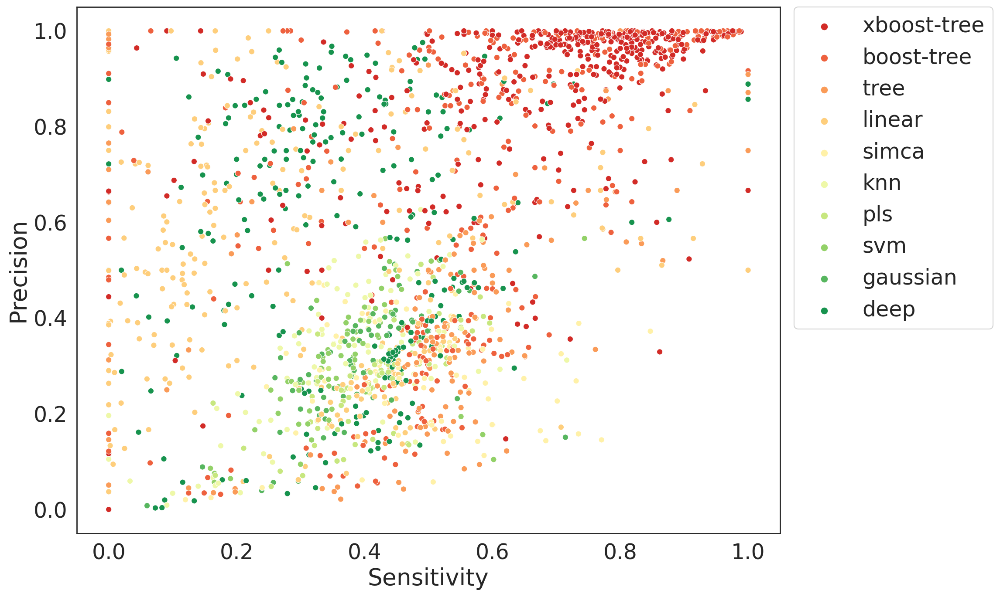

In [17]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      'font.size' : 22}
plt.rcParams.update(rc)
plt.figure(figsize=(13,10), dpi= 80)
sns.set_style("white")
hue_order =['xboost-tree','boost-tree','tree', 'linear', 'simca', 'knn', 'pls', 'svm','gaussian', 'deep']

ax = sns.scatterplot(data=dff_mechT_mean, x="sensitivity", y="precision",
                hue="model", palette="RdYlGn", 
               hue_order=hue_order, linewidth=0.5, alpha = 1)
handles, labels  =  ax.get_legend_handles_labels() 
ax.set_title('')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0) 
ax.set(xlabel='Sensitivity', ylabel='Precision')
plt.savefig('../plots/knime/scatter_permechtarget_sensitivity-vs-precision_hue-model.png', bbox_inches = 'tight')

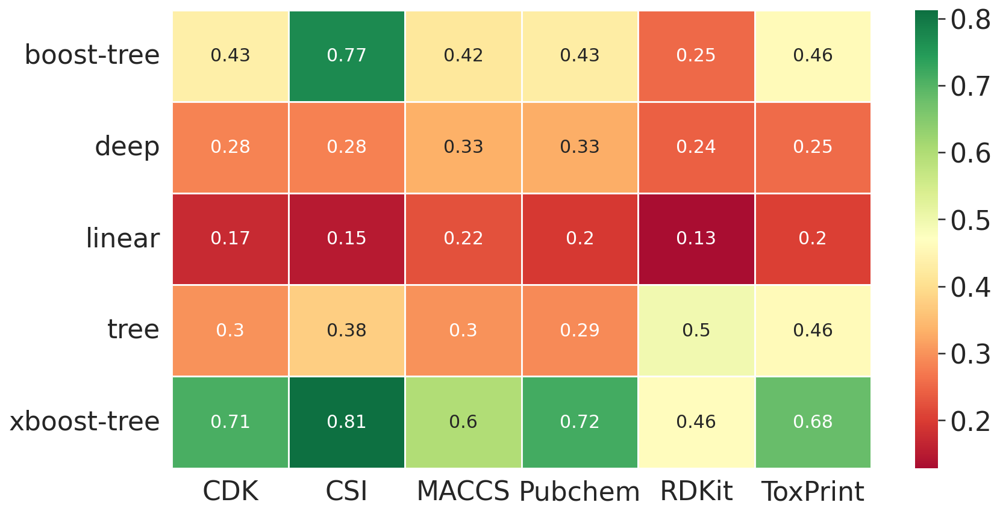

In [66]:
# for the heatmap we present just a subset from knime results. CSI fps were not tested on daint. 
%config InlineBackend.figure_format = 'retina'
df_sel = df_knime_oob[["sensitivity", "model", "fps_class"]]
df_sel_avg = df_sel.groupby(["model", "fps_class"], as_index=False).mean('sensitivity')
sorter = ["linear, ""deep", "tree", "boots-tree", "xboost-tree"]
df_sel_avg = df_sel_avg.reindex(sorter)
counts = df_sel.groupby(['model','fps_class']).size().reset_index().rename(columns={0:'count'})
fig, ax = plt.subplots(figsize=(13,7))
ax = sns.heatmap(df_sel_avg_piv, cmap="RdYlGn", alpha = 0.95, linewidths=0.70, linecolor='white', annot=True,  fmt='.2g')
plt.xlabel('')
plt.ylabel('')

#RdYlGn
#PiYG
plt.savefig('../plots/knime/heatmap_model-vs-molfps_meansensitivity.png', bbox_inches = 'tight')

In [59]:
df_sel.head(20)

,sensitivity,model,fps_class
8292,0.0,xboost-tree,CDK
8293,0.0,xboost-tree,CDK
8294,0.0,xboost-tree,CDK
8295,0.0,xboost-tree,CDK
8296,0.0,linear,CDK
8297,0.0,linear,CDK
8298,0.0,linear,CDK
8299,0.0,linear,CDK
8300,0.0,boost-tree,RDKit
8301,0.0,boost-tree,RDKit


In [ ]:
# for the heatmap we present just a subset from knime results. CSI fps were not tested on daint. 
%config InlineBackend.figure_format = 'retina'
df_sel = df_con[["sensitivity", "model", "fps_class"]]
df_sel_avg = df_sel.groupby(["model", "fps_class"], as_index=False).mean('sensitivity')
df_sel_avg_piv = df_sel_avg.pivot("model", "fps_class", "sensitivity")
ax = sns.heatmap(df_sel_avg_piv, cmap="RdYlGn")
#RdYlGn
#PiYG
plt.savefig('../plots/knime/heatmap_model-vs-molfps_meansensitivity.png', bbox_inches = 'tight')

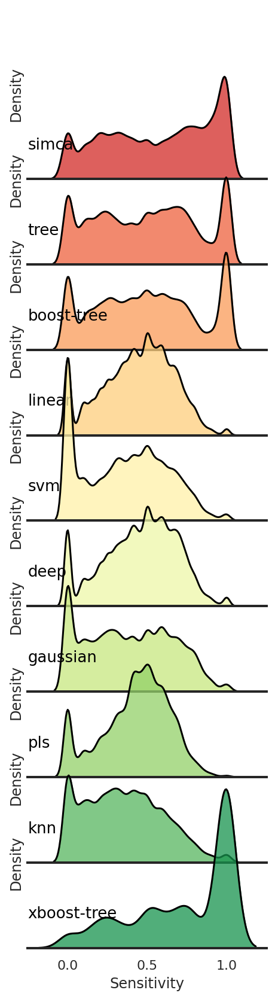

In [46]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
palette = sns.color_palette("RdYlGn", 10)
g = sns.FacetGrid(df_daint, palette=palette, row="model", hue="model", aspect=3, height=1.2)
g.map_dataframe(sns.kdeplot, x="sensitivity", fill=True, alpha=0.75)
g.map_dataframe(sns.kdeplot, x="sensitivity", color='black')
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color='black', fontsize=13,
            ha="left", va="center", transform=ax.transAxes)
    
g.map(label, "model")
g.fig.subplots_adjust(hspace=-.5)
g.set_titles("")
g.set(yticks=[], xlabel="Sensitivity")
g.despine(left=True)
#plt.suptitle('ML performance by model', y=0.98)
plt.savefig('../plots/knime/kde_sensitivity_daint_model_ridge.svg', bbox_inches = 'tight', dpi=300)

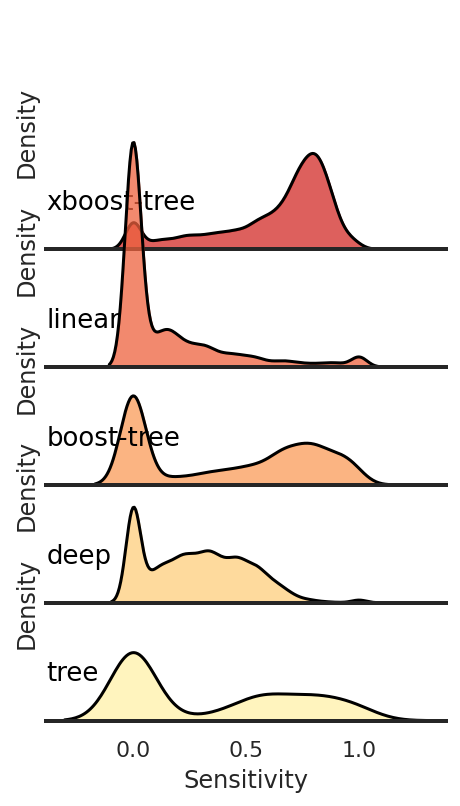

In [47]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
palette = sns.color_palette("RdYlGn", 10)
g = sns.FacetGrid(df_knime_oob, palette=palette, row="model", hue="model", aspect=3, height=1.2)
g.map_dataframe(sns.kdeplot, x="sensitivity", fill=True, alpha=0.75)
g.map_dataframe(sns.kdeplot, x="sensitivity", color='black')
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color='black', fontsize=13,
            ha="left", va="center", transform=ax.transAxes)
    
g.map(label, "model")
g.fig.subplots_adjust(hspace=-.5)
g.set_titles("")
g.set(yticks=[], xlabel="Sensitivity")
g.despine(left=True)
#plt.suptitle('ML performance by model', y=0.98)
plt.savefig('../plots/knime/kde_sensitivity_knieoob_model_ridge.svg', bbox_inches = 'tight', dpi=300)

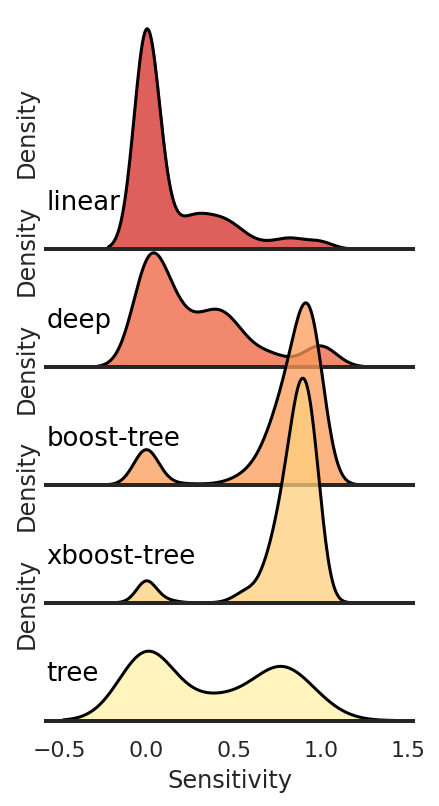

In [48]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
palette = sns.color_palette("RdYlGn", 10)
g = sns.FacetGrid(df_csi, palette=palette, row="model", hue="model", aspect=3, height=1.2)
g.map_dataframe(sns.kdeplot, x="sensitivity", fill=True, alpha=0.75)
g.map_dataframe(sns.kdeplot, x="sensitivity", color='black')
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color='black', fontsize=13,
            ha="left", va="center", transform=ax.transAxes)
    
g.map(label, "model")
g.fig.subplots_adjust(hspace=-.5)
g.set_titles("")
g.set(yticks=[], xlabel="Sensitivity")
g.despine(left=True)
#plt.suptitle('ML performance by model', y=0.98)
plt.savefig('../plots/knime/kde_sensitivity_csi_model_ridge.svg', bbox_inches = 'tight', dpi=300)

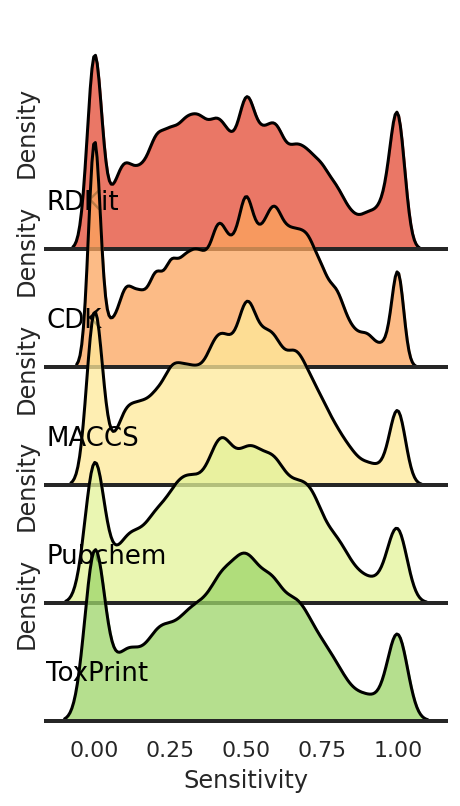

In [49]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
palette = sns.color_palette("RdYlGn", 6)
g = sns.FacetGrid(df_daint, palette=palette, row="fps_class", hue="fps_class", aspect=3, height=1.2)
g.map_dataframe(sns.kdeplot, x="sensitivity", fill=True, alpha=0.75)
g.map_dataframe(sns.kdeplot, x="sensitivity", color='black')
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color='black', fontsize=13,
            ha="left", va="center", transform=ax.transAxes)
    
g.map(label, "fps_class")
g.fig.subplots_adjust(hspace=-.5)
g.set_titles("")
g.set(yticks=[], xlabel="Sensitivity")
g.despine(left=True)
#plt.suptitle('ML performance by model', y=0.98)
plt.savefig('../plots/knime/kde_sensitivity_daint_fps_ridge.svg', bbox_inches = 'tight', dpi=300)

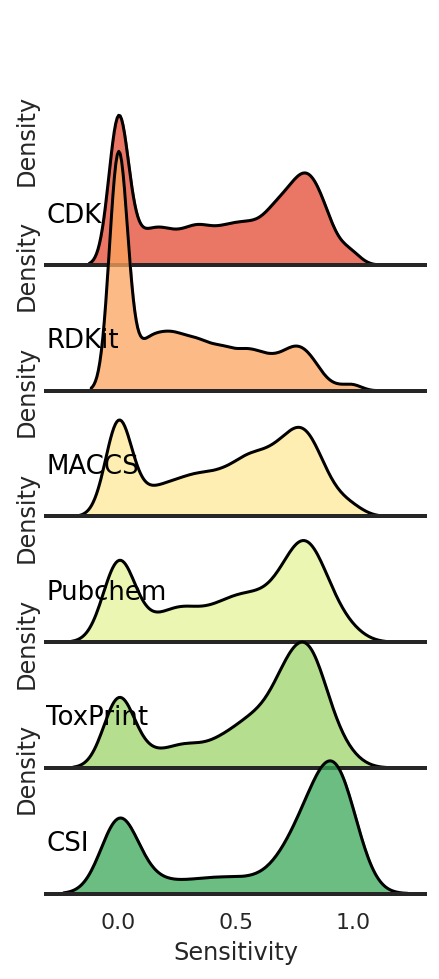

In [50]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
palette = sns.color_palette("RdYlGn", 6)
g = sns.FacetGrid(df_knime_oob, palette=palette, row="fps_class", hue="fps_class", aspect=3, height=1.2)
g.map_dataframe(sns.kdeplot, x="sensitivity", fill=True, alpha=0.75)
g.map_dataframe(sns.kdeplot, x="sensitivity", color='black')
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color='black', fontsize=13,
            ha="left", va="center", transform=ax.transAxes)
    
g.map(label, "fps_class")
g.fig.subplots_adjust(hspace=-.5)
g.set_titles("")
g.set(yticks=[], xlabel="Sensitivity")
g.despine(left=True)
#plt.suptitle('ML performance by model', y=0.98)
plt.savefig('../plots/knime/kde_sensitivity_knimeoob_fps_ridge.svg', bbox_inches = 'tight', dpi=300)

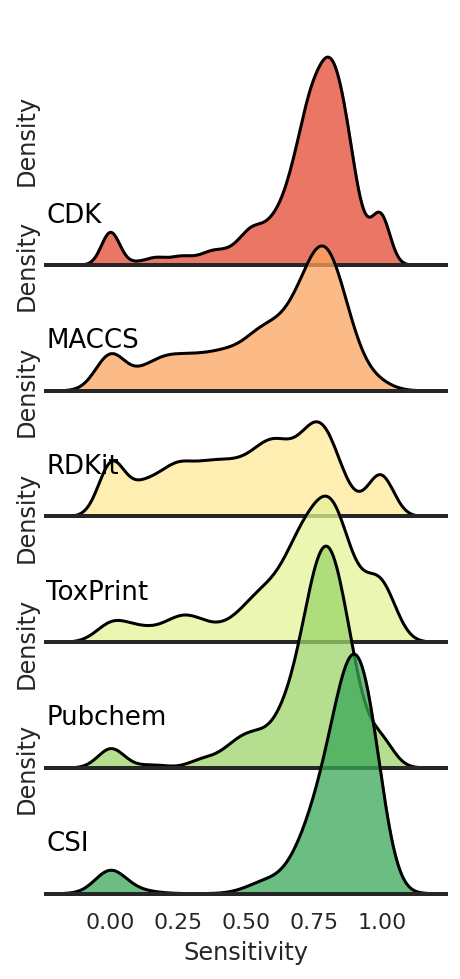

In [51]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
palette = sns.color_palette("RdYlGn", 6)
g = sns.FacetGrid(df_xboost, palette=palette, row="fps_class", hue="fps_class", aspect=3, height=1.2)
g.map_dataframe(sns.kdeplot, x="sensitivity", fill=True, alpha=0.75)
g.map_dataframe(sns.kdeplot, x="sensitivity", color='black')
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color='black', fontsize=13,
            ha="left", va="center", transform=ax.transAxes)
    
g.map(label, "fps_class")
g.fig.subplots_adjust(hspace=-.5)
g.set_titles("")
g.set(yticks=[], xlabel="Sensitivity")
g.despine(left=True)
#plt.suptitle('ML performance by model', y=0.98)
plt.savefig('../plots/knime/kde_sensitivity_xgb_model_ridge.svg', bbox_inches = 'tight', dpi=300)

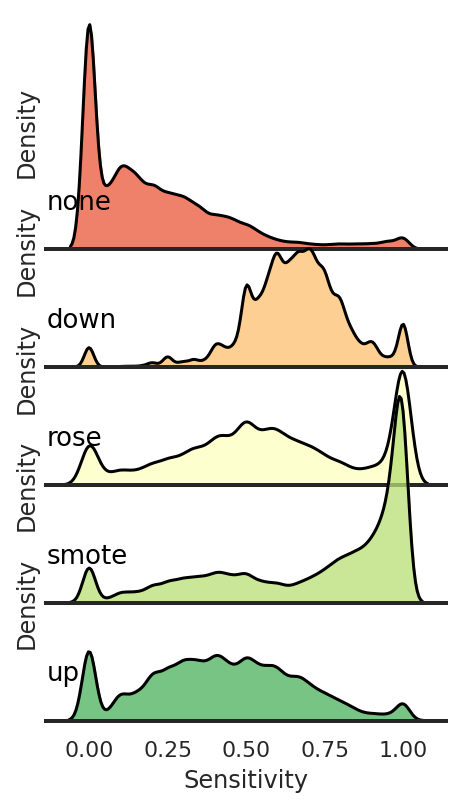

In [52]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
palette = sns.color_palette("RdYlGn", 5)
g = sns.FacetGrid(df, palette=palette, row="subsampling", hue="subsampling", aspect=3, height=1.2)
g.map_dataframe(sns.kdeplot, x="sensitivity", fill=True, alpha=0.75)
g.map_dataframe(sns.kdeplot, x="sensitivity", color='black')
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color='black', fontsize=13,
            ha="left", va="center", transform=ax.transAxes)
    
g.map(label, "subsampling")
g.fig.subplots_adjust(hspace=-.5)
g.set_titles("")
g.set(yticks=[], xlabel="Sensitivity")
g.despine(left=True)
#plt.suptitle('ML performance by model', y=0.98)
plt.savefig('../plots/knime/kde_sensitivity_subsampling_daint_ridge.svg', bbox_inches = 'tight', dpi=300)

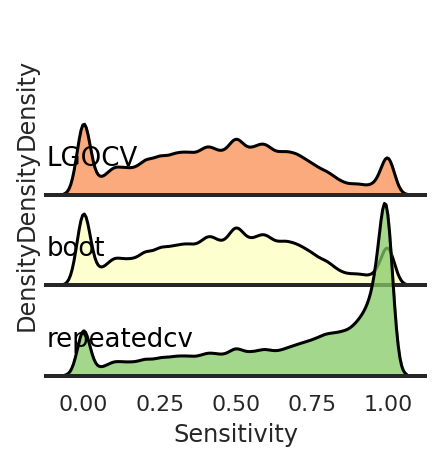

In [53]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
palette = sns.color_palette("RdYlGn", 3)
g = sns.FacetGrid(df, palette=palette, row="resampling", hue="resampling", aspect=3, height=1.2)
g.map_dataframe(sns.kdeplot, x="sensitivity", fill=True, alpha=0.75)
g.map_dataframe(sns.kdeplot, x="sensitivity", color='black')
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color='black', fontsize=13,
            ha="left", va="center", transform=ax.transAxes)
    
g.map(label, "resampling")
g.fig.subplots_adjust(hspace=-.5)
g.set_titles("")
g.set(yticks=[], xlabel="Sensitivity")
g.despine(left=True)
#plt.suptitle('ML performance by model', y=0.98)
plt.savefig('../plots/knime/kde_sensitivity_resampling_ridge.svg', bbox_inches = 'tight', dpi=300)

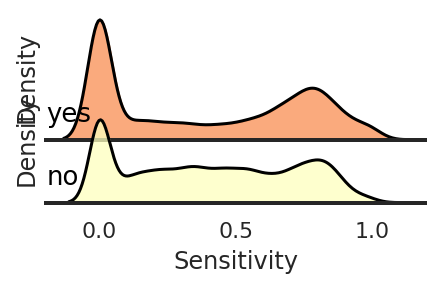

In [54]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
palette = sns.color_palette("RdYlGn", 3)
g = sns.FacetGrid(df_knime_oob, palette=palette, row="cyto", hue="cyto", aspect=3, height=1.2)
g.map_dataframe(sns.kdeplot, x="sensitivity", fill=True, alpha=0.75)
g.map_dataframe(sns.kdeplot, x="sensitivity", color='black')
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color='black', fontsize=13,
            ha="left", va="center", transform=ax.transAxes)
    
g.map(label, "cyto")
g.fig.subplots_adjust(hspace=-.5)
g.set_titles("")
g.set(yticks=[], xlabel="Sensitivity")
g.despine(left=True)
#plt.suptitle('ML performance by model', y=0.98)
plt.savefig('../plots/knime/kde_sensitivity_knimeoob_cyto_ridge.svg', bbox_inches = 'tight', dpi=300)

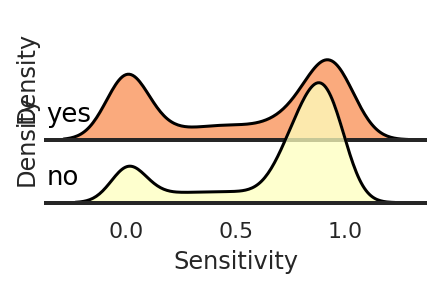

In [101]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
palette = sns.color_palette("RdYlGn", 3)
g = sns.FacetGrid(df_csi, palette=palette, row="cyto", hue="cyto", aspect=3, height=1.2)
g.map_dataframe(sns.kdeplot, x="sensitivity", fill=True, alpha=0.75)
g.map_dataframe(sns.kdeplot, x="sensitivity", color='black')
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color='black', fontsize=13,
            ha="left", va="center", transform=ax.transAxes)
    
g.map(label, "cyto")
g.fig.subplots_adjust(hspace=-.5)
g.set_titles("")
g.set(yticks=[], xlabel="Sensitivity")
g.despine(left=True)
#plt.suptitle('ML performance by model', y=0.98)
plt.savefig('../plots/knime/kde_sensitivity_cyto_csi_ridge.svg', bbox_inches = 'tight', dpi=300)

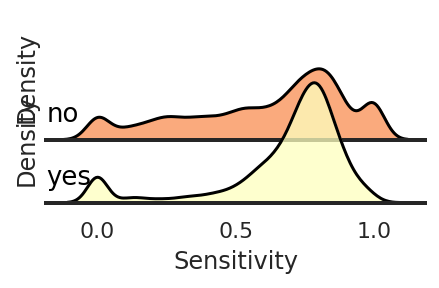

In [100]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
palette = sns.color_palette("RdYlGn", 3)
g = sns.FacetGrid(df_xboost, palette=palette, row="cyto", hue="cyto", aspect=3, height=1.2)
g.map_dataframe(sns.kdeplot, x="sensitivity", fill=True, alpha=0.75)
g.map_dataframe(sns.kdeplot, x="sensitivity", color='black')
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color='black', fontsize=13,
            ha="left", va="center", transform=ax.transAxes)
    
g.map(label, "cyto")
g.fig.subplots_adjust(hspace=-.5)
g.set_titles("")
g.set(yticks=[], xlabel="Sensitivity")
g.despine(left=True)
#plt.suptitle('ML performance by model', y=0.98)
plt.savefig('../plots/knime/kde_sensitivity_cyto_xboost_ridge.svg', bbox_inches = 'tight', dpi=300)

In [32]:
dff_mechT_mean.head()
dff_mechT_mean.columns

Index(['mechT', 'fps_class', 'model', 'cyto', 'sensitivity', 'specificity',
       'precision', 'F', 'accuracy', 'cohen'],
      dtype='object')

In [ ]:
# each point represents an average modelling outcome for a specific combination of target, model, fps, and cytotox acrocc all availble endpoints. 
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      #'font.family':'Times New Roman',
      'font.size' : 15}
hue_order =['CSI','CDK','ToxPrint', 'Pubchem', 'MACCS', 'RDKit']
hue_order2 =['RDKit', 'MACCS','Pubchem', 'ToxPrint', 'CDK','CSI']
plt.rcParams.update(rc)

g = sns.FacetGrid(dff_mechT_mean, col="mechT", col_wrap=6, hue="fps_class", palette="RdYlGn", height=5, hue_order=hue_order2)
g.map(sns.scatterplot, "sensitivity", "precision", s=400,
      edgecolor = "black", linewidth=0.5, alpha = 0.75)
g.add_legend()
g.set_axis_labels("Sensitivity", "Precision")
g.set(xticks=[0, 0.25, 0.5, 0.75, 1], yticks=[0, 0.25, 0.5, 0.75, 1])
# g.figure.subplots_adjust(wspace=.02, hspace=.02)
g.set_titles(row_template = '{row_name}', col_template = '{col_name}')
plt.savefig('../plots/knime/grids_p-vs-s_gb-mechT_fps.svg', bbox_inches = 'tight', dpi = 300)

In [24]:
dff_mechT_mean.fps_class.unique()

array(['CDK', 'CSI', 'MACCS', 'Pubchem', 'RDKit', 'ToxPrint'],
      dtype=object)

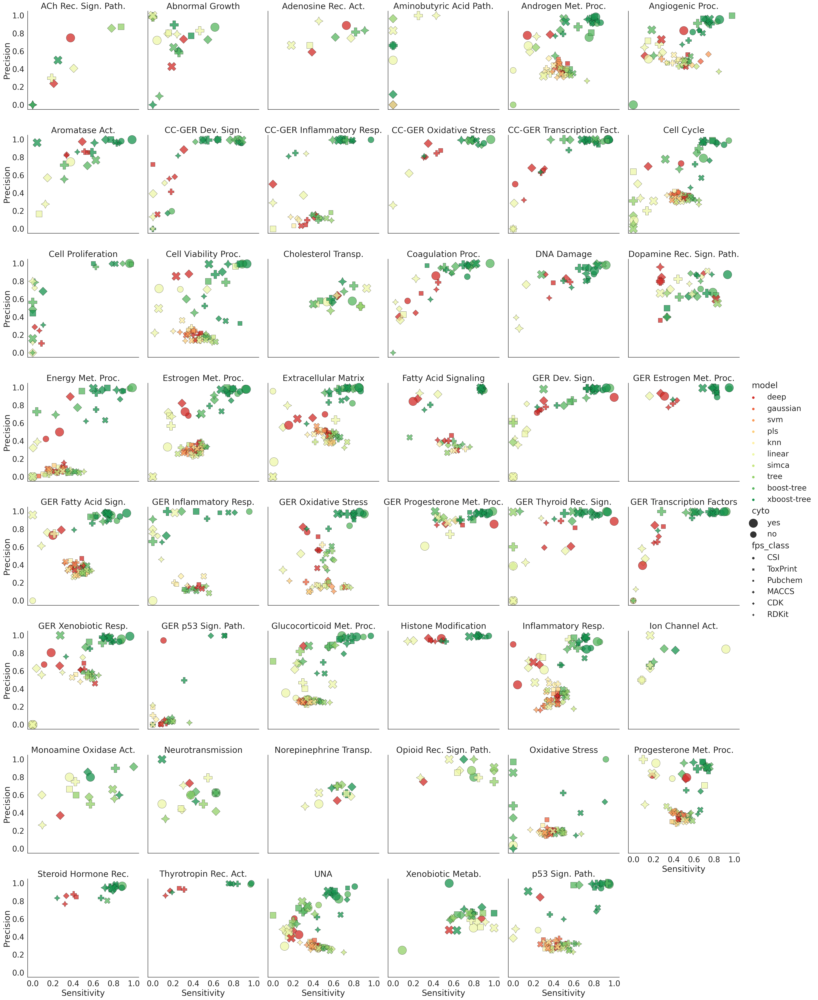

In [99]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      #'font.family':'Times New Roman',
      'font.size' : 15}
plt.rcParams.update(rc)
hue_order =['deep', 'gaussian', 'svm', 'pls',  'knn', 'linear', 'simca', 'tree', 'boost-tree', 'xboost-tree']
style_order = ['CSI','ToxPrint', 'Pubchem', 'MACCS','CDK', 'RDKit']
g = sns.relplot(
    data=dff_mechT_mean, x="sensitivity", y="precision", col="mechT",col_wrap=6,
    hue="model", style = "fps_class", size="cyto",
    palette='RdYlGn', sizes=(300, 600), alpha = 0.75, edgecolor = "black", linewidth=0.5,
    hue_order=hue_order, style_order=style_order)
for item, ax in g.axes_dict.items():
     ax.grid(False, axis='x')
     ax.set_title(item) 
g.set_axis_labels("Sensitivity", "Precision")
g.set(xticks=[0, 0.2, 0.4, 0.6, 0.8, 1], yticks=[0, 0.2, 0.4, 0.6, 0.8, 1])
plt.savefig('../plots/knime/sensitivity_per_mech_relplot.svg', bbox_inches = 'tight', dpi = 300)

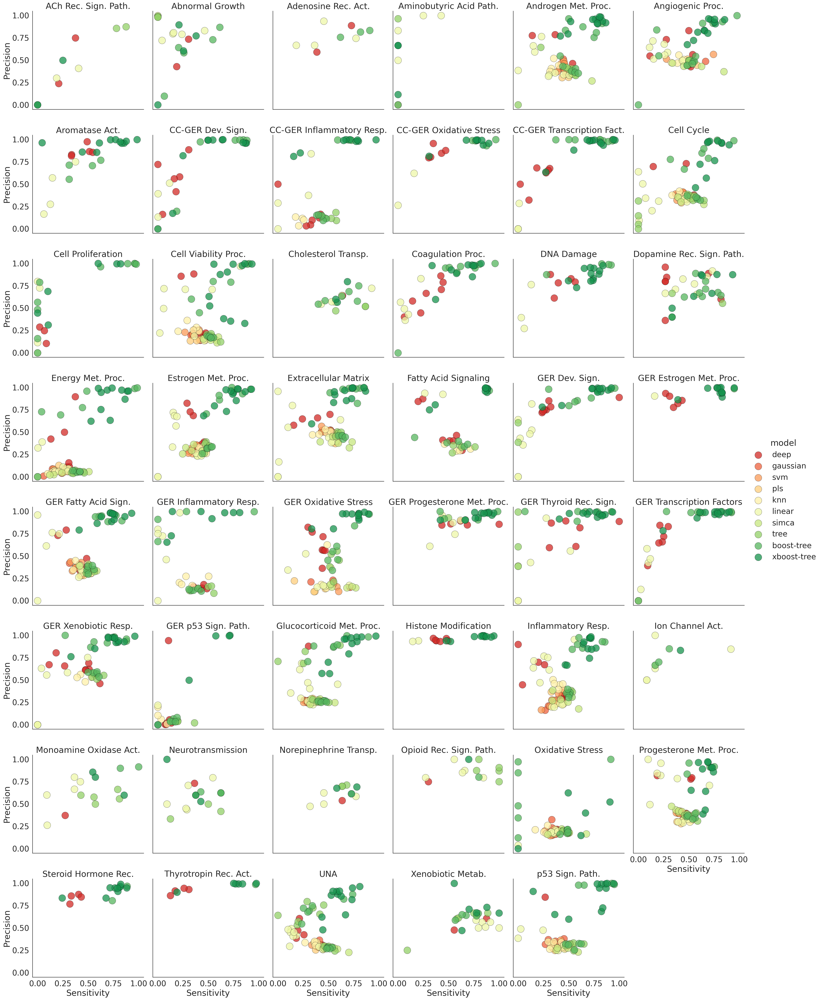

In [61]:
# each point represents an average modelling outcome for a specific combination of target, model, fps, and cytotox acrocc all availble endpoints. 
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      #'font.family':'Times New Roman',
      'font.size' : 15}
hue_order =['xboost-tree','boost-tree','tree', 'linear', 'simca', 'knn', 'pls', 'svm','gaussian', 'deep']
hue_order2 =['deep', 'gaussian', 'svm', 'pls',  'knn', 'linear', 'simca', 'tree', 'boost-tree', 'xboost-tree']
plt.rcParams.update(rc)

g = sns.FacetGrid(dff_mechT_mean, col="mechT", col_wrap=6, hue="model", palette="RdYlGn", height=5, hue_order = hue_order2)
g.map(sns.scatterplot, "sensitivity", "precision", s=400,
      edgecolor = "black", linewidth=0.5, alpha = 0.75)
g.add_legend()
g.set_axis_labels("Sensitivity", "Precision")
g.set(xticks=[0, 0.25, 0.5, 0.75, 1], yticks=[0, 0.25, 0.5, 0.75, 1])
# g.figure.subplots_adjust(wspace=.02, hspace=.02)
g.set_titles(row_template = '{row_name}', col_template = '{col_name}')
plt.savefig('../plots/knime/grids_p-vs-s_gb-mechT_model.svg', bbox_inches = 'tight', dpi = 1200)

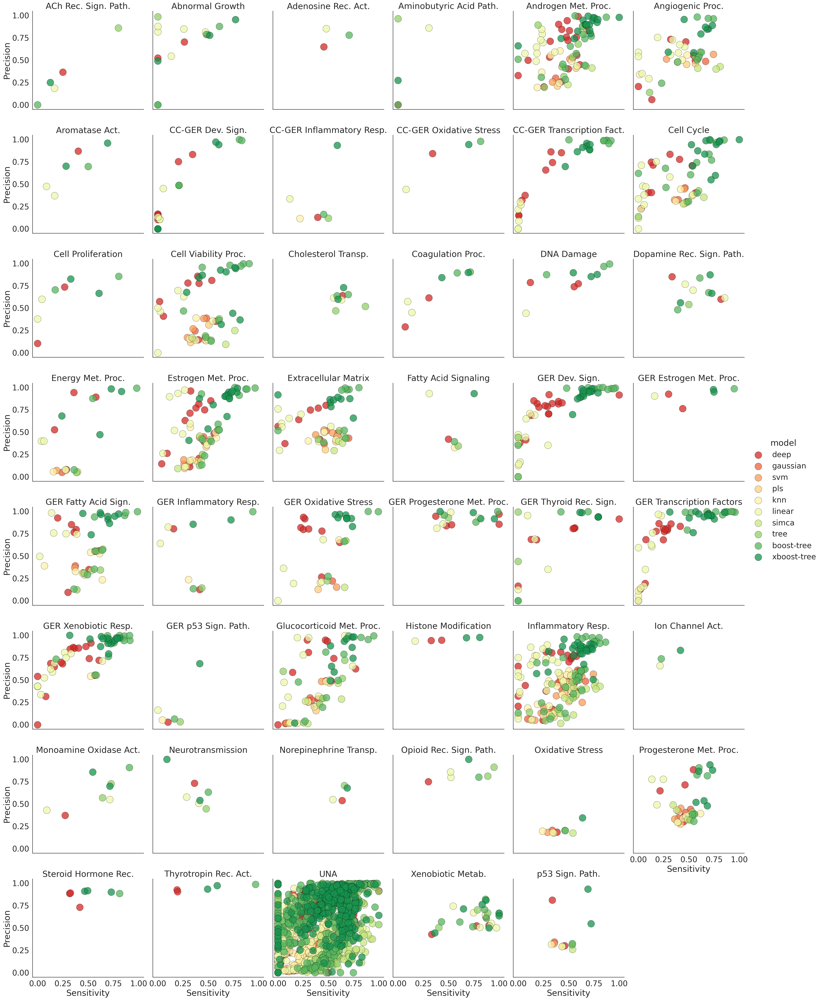

In [62]:
# each point represents an average modelling outcome for a specific target, endpiont, and model for all combinations fps, and cytotox. 
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      #'font.family':'Times New Roman',
      'font.size' : 15}
hue_order =['xboost-tree','boost-tree','tree', 'linear', 'simca', 'knn', 'pls', 'svm','gaussian', 'deep']
hue_order2 =['deep', 'gaussian', 'svm', 'pls',  'knn', 'linear', 'simca','tree', 'boost-tree', 'xboost-tree']
plt.rcParams.update(rc)

g = sns.FacetGrid(dff_assay_mean_model, col="mechT", col_wrap=6, hue="model", palette="RdYlGn", height=5, hue_order=hue_order2)
g.map(sns.scatterplot, "sensitivity", "precision", s=400,
      edgecolor = "black", linewidth=0.5, alpha = 0.75)
g.add_legend()
g.set_axis_labels("Sensitivity", "Precision")
g.set(xticks=[0, 0.25, 0.5, 0.75, 1], yticks=[0, 0.25, 0.5, 0.75, 1])
# g.figure.subplots_adjust(wspace=.02, hspace=.02)
g.set_titles(row_template = '{row_name}', col_template = '{col_name}')
plt.savefig('../plots/knime/grids_p-vs-s_gb-assay_model_mean.svg', bbox_inches = 'tight', dpi = 1200)

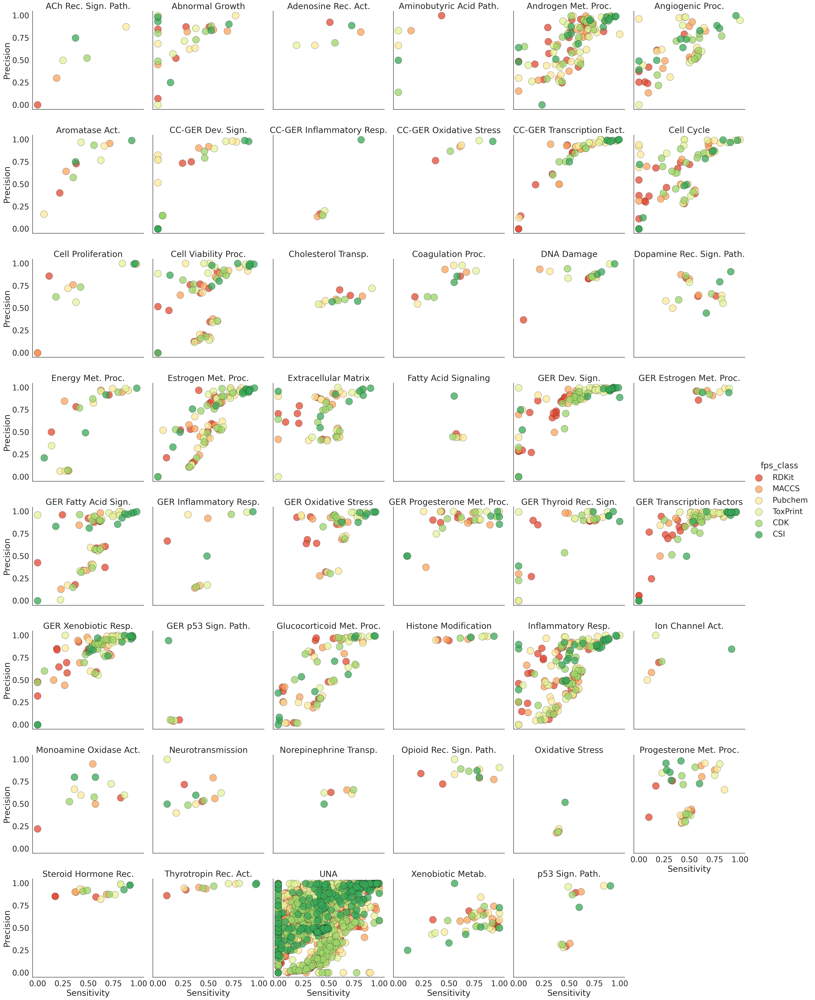

In [60]:
# each point represents an average modelling outcome for a specific target, endpiont, and fps for all combinations model, and cytotox. 
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      #'font.family':'Times New Roman',
      'font.size' : 15}
hue_order =['CSI','CDK','ToxPrint', 'Pubchem', 'MACCS', 'RDKit']
hue_order2 =['RDKit', 'MACCS','Pubchem', 'ToxPrint', 'CDK','CSI']
plt.rcParams.update(rc)

g = sns.FacetGrid(dff_assay_mean_fps, col="mechT", col_wrap=6, hue="fps_class", palette="RdYlGn", height=5, hue_order=hue_order2)
g.map(sns.scatterplot, "sensitivity", "precision", s=400,
      edgecolor = "black", linewidth=0.5, alpha = 0.75)
g.add_legend()
g.set_axis_labels("Sensitivity", "Precision")
g.set(xticks=[0, 0.25, 0.5, 0.75, 1], yticks=[0, 0.25, 0.5, 0.75, 1])
# g.figure.subplots_adjust(wspace=.02, hspace=.02)
g.set_titles(row_template = '{row_name}', col_template = '{col_name}')
plt.savefig('../plots/knime/grids_p-vs-s_gb-assay_fps_mean.svg', bbox_inches = 'tight', dpi = 1200)

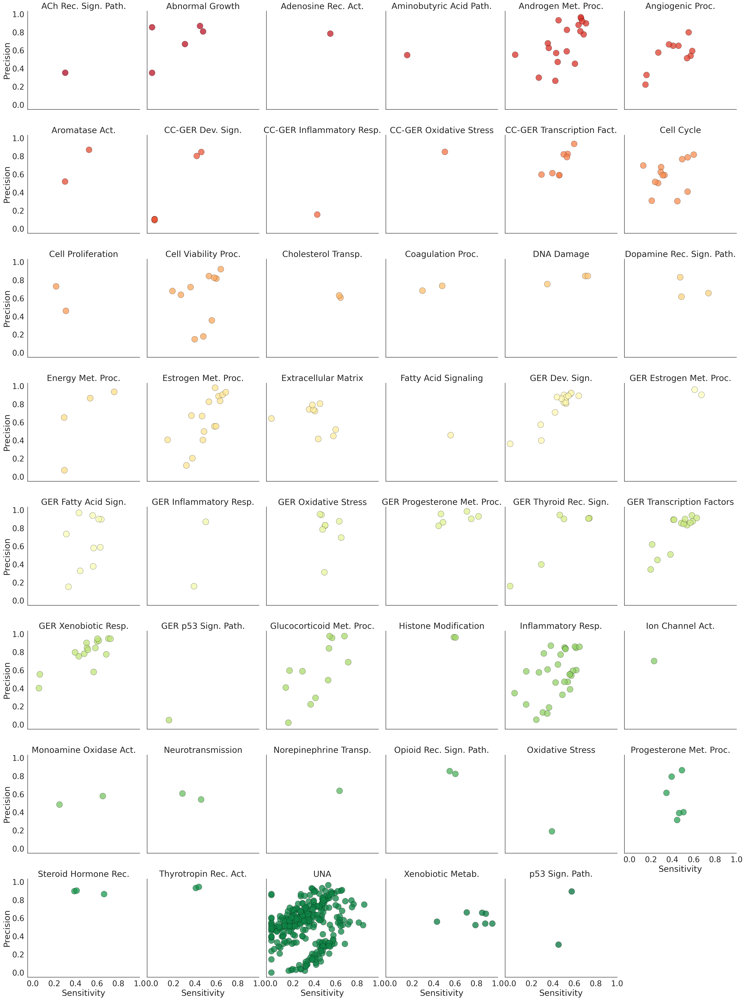

In [105]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      #'font.family':'Times New Roman',
      'font.size' : 15}
plt.rcParams.update(rc)
g = sns.relplot(
    data=dff_assay_mean, x="sensitivity", y="precision", col="mechT",col_wrap=6,
    hue="mechT", palette='RdYlGn', alpha = 0.75, edgecolor = "black", linewidth=0.5, s = 300)
for item, ax in g.axes_dict.items():
     ax.grid(False, axis='x')
     ax.set_title(item) 
g.set_axis_labels("Sensitivity", "Precision")
g.set(xticks=[0, 0.2, 0.4, 0.6, 0.8, 1], yticks=[0, 0.2, 0.4, 0.6, 0.8, 1])
g._legend.remove()
plt.savefig('../plots/knime/sensitivity_per_assay_relplot.svg', bbox_inches = 'tight', dpi = 300)

In [47]:
df_corr = df_final_target.drop(['ctb', 'hitc_perc', 'aeid_unique#', 'hitc_count'], axis=1)
df_corr = df_corr.rename(columns={'hitc_sum': 'hitc1%', 'DTXSID_unique#': 'DTXSID#'})
corr = df_corr.corr()
corr.style.background_gradient(cmap="RdYlGn")
plt.savefig('../plots/knime/correlation_of_metrics.png', bbox_inches = 'tight')

<Figure size 1440x720 with 0 Axes>

In [37]:
df_wc_mechT_cyto_melted = pd.melt(df_wc_mechT_cyto, 
   id_vars = ['mechT', 'cyto'], 
   value_vars = ['sensitivity', 'accuracy', 'precision'], 
   var_name = 'Metrics', 
   value_name = 'Value',
   ignore_index = False)

%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(21,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      'font.size' : 22}
plt.rcParams.update(rc)
plt.figure(figsize=(15,10), dpi= 300)
sns.set_style("white")
palette = {"sensitivity":"tab:cyan",
           "precision":"tab:orange", 
           "accuracy":"tab:purple"}

palette2 = {"sensitivity":"#45ad5b",
           "precision":"#fdb567", 
           "accuracy":'#d83128'}

mechs_to_replace = {'Androgen Met. Proc.':'AR-MP',
                    'Angiogenic Proc.' :'ANG-P',
                    'Aromatase Act.':'ARO-A',
                    'CC-GER Developmental Sign.':'CC-GER-DS',
                    'CC-GER Inflammatory Resp.':'CC-GER-IR',
                    'CC-GER Oxidative Stress':'CC-GER-OS',
                    'CC-GER Transcription Fact.':'CC-GER-TF',
                    'Cell Cycle':'CC',
                    'Cell Viability Proc.':'CVP',
                    'Coagulation Proc.':'CP',
                    'DNA Damage':'DNA-D',
                    'Dopamine Rec. Sign. Path.':'DR-SP',
                    'Energy Met. Proc.':'EN-MP',
                    'Estrogen Met. Proc.':'ER-MP',
                    'Extracellular Matrix':'EXM',
                    'GER Developmental Sign.':'GER-DS',
                    'GER Estrogen Met. Proc.':'GER-ER-MP',
                    'GER Fatty Acid Sign.':'GER-FA-S',
                    'GER Glucocorticoid Met. Proc.':'GER-GLC-MP',
                    'GER Oxidative Stress':'GER-OS',
                    'GER Progesterone Met. Proc.':'GER-PR-MP',
                    'GER Steroid Hormone Nuclear Rec.':'GER-StH-NR',
                    'GER Thyroid Rec. Sign.':'GER-ThR-S',
                    'GER Transcription Factors':'GER-TF',
                    'GER Xenobiotic Resp.':'GER-XR',
                    'Glucocorticoid Met. Proc.':'GLC-MP',
                    'Histone Modification':'HM',
                    'Inflammatory Resp.':'IR',
                    'Monoamine Oxidase Act.':'MO-A',
                    'Progesterone Met. Proc.':'PR-MP',
                    'Thyrotropin Rec. Act.':'ThR-A',
                    'UNA':'UNA',
                    'Xenobiotic Metab.':'XM',
                    'p53 Sign. Path.':'p53-SP'}
df_wc_mechT_cyto_melted = df_wc_mechT_cyto_melted.drop(df_wc_mechT_cyto_melted[df_wc_mechT_cyto_melted['mechT'] == "UNA"].index)
df_wc_mechT_cyto_melted['mechTT'] = df_wc_mechT_cyto_melted['mechT'].map(mechs_to_replace)
g = sns.lineplot(data=df_wc_mechT_cyto_melted, x='mechTT', y='Value', hue='Metrics', style = "cyto", palette=palette2, linewidth=2)
g = sns.scatterplot(data=df_wc_mechT_cyto_melted, x='mechTT', y='Value', style = "cyto", hue='Metrics',  palette = palette2, s=100)
plt.xticks(rotation=90)
g.axhline(0.85, color = "gray")
g.set(xlabel='', ylabel='Evalution metric')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0) 
plt.savefig('../plots/knime/lineplot_datafinal_sens-vs-precision_16.svg', bbox_inches = 'tight', dpi = 300)
#plt.xticks(np.arange(min(x), max(x)+1), 1.0)
print(df_wc_mechT_cyto_melted["mechTT"].unique())
print(df_wc_mechT_cyto_melted["mechT"].unique())


['AR-MP' 'ANG-P' 'ARO-A' 'CC-GER-DS' 'CC-GER-IR' 'CC-GER-OS' 'CC-GER-TF'
 'CC' 'CVP' 'CP' 'DNA-D' 'DR-SP' 'EN-MP' 'ER-MP' 'EXM' 'GER-DS'
 'GER-ER-MP' 'GER-FA-S' 'GER-GLC-MP' 'GER-OS' 'GER-PR-MP' 'GER-StH-NR'
 'GER-ThR-S' 'GER-TF' 'GER-XR' 'GLC-MP' 'HM' 'IR' 'MO-A' 'PR-MP' 'ThR-A'
 'XM' 'p53-SP']
['Androgen Met. Proc.' 'Angiogenic Proc.' 'Aromatase Act.'
 'CC-GER Developmental Sign.' 'CC-GER Inflammatory Resp.'
 'CC-GER Oxidative Stress' 'CC-GER Transcription Fact.' 'Cell Cycle'
 'Cell Viability Proc.' 'Coagulation Proc.' 'DNA Damage'
 'Dopamine Rec. Sign. Path.' 'Energy Met. Proc.' 'Estrogen Met. Proc.'
 'Extracellular Matrix' 'GER Developmental Sign.'
 'GER Estrogen Met. Proc.' 'GER Fatty Acid Sign.'
 'GER Glucocorticoid Met. Proc.' 'GER Oxidative Stress'
 'GER Progesterone Met. Proc.' 'GER Steroid Hormone Nuclear Rec.'
 'GER Thyroid Rec. Sign.' 'GER Transcription Factors'
 'GER Xenobiotic Resp.' 'Glucocorticoid Met. Proc.' 'Histone Modification'
 'Inflammatory Resp.' 'Monoamine Oxida

In [9]:
order = df_wc_mechT_cyto_melted.mechTT.sort_values().unique()
print(order)

['ANG-P' 'AR-MP' 'ARO-A' 'CC' 'CC-GER-DS' 'CC-GER-IR' 'CC-GER-OS'
 'CC-GER-TF' 'CP' 'CVP' 'DNA-D' 'DR-SP' 'EN-MP' 'ER-MP' 'EXM' 'GER-DS'
 'GER-ER-MP' 'GER-FA-S' 'GER-GLC-MP' 'GER-OS' 'GER-PR-MP' 'GER-StH-NR'
 'GER-TF' 'GER-ThR-S' 'GER-XR' 'GLC-MP' 'HM' 'IR' 'MO-A' 'PR-MP' 'ThR-A'
 'UNA' 'XM' 'p53-SP']


array(['ANG-P', 'AR-MP', 'ARO-A', 'CC', 'CC-GER-DS', 'CC-GER-IR',
       'CC-GER-OS', 'CC-GER-TF', 'CP', 'CVP', 'DNA-D', 'DR-SP', 'EN-MP',
       'ER-MP', 'EXM', 'GER-DS', 'GER-ER-MP', 'GER-FA-S', 'GER-GLC-MP',
       'GER-OS', 'GER-PR-MP', 'GER-StH-NR', 'GER-TF', 'GER-ThR-S',
       'GER-XR', 'GLC-MP', 'HM', 'IR', 'MO-A', 'PR-MP', 'ThR-A', 'XM',
       'p53-SP'], dtype=object)

<Figure size 3900x3000 with 0 Axes>

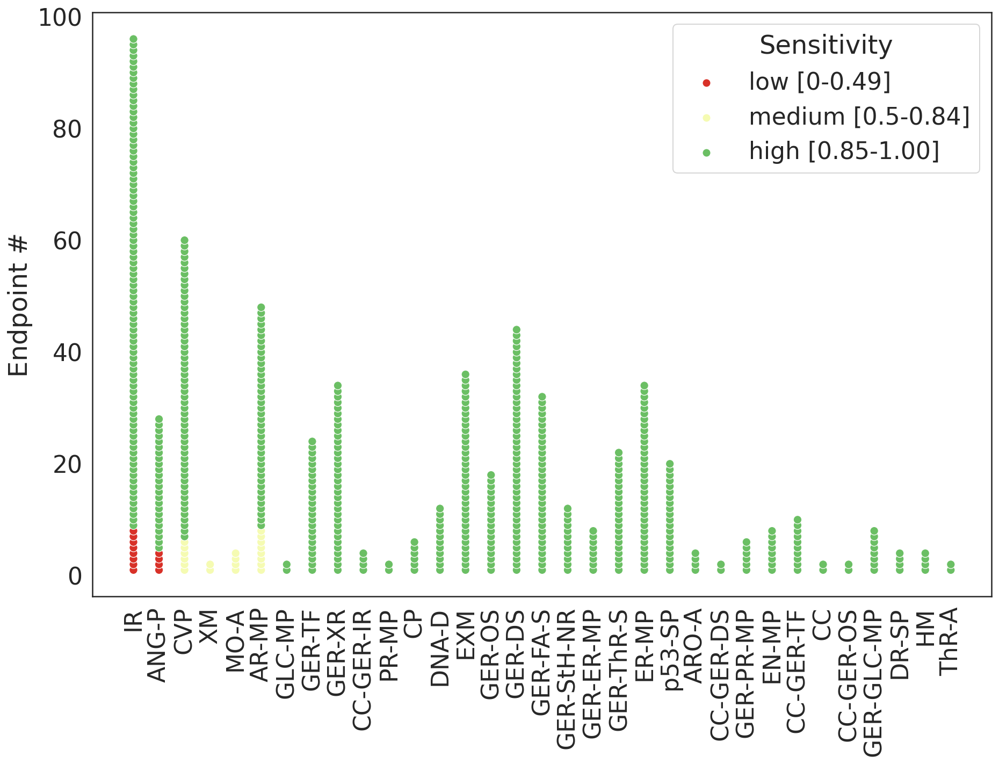

In [25]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      'font.size' : 22}
plt.rcParams.update(rc)
plt.figure(figsize=(13,10), dpi= 300)
sns.set_style("white")
palette3 = {"0.0-0.49":'#d83128',"0.5-0.84":"#f5fbb2", "0.85-1.0":"#6bbf64"}

df_wc_dot = df_wc.sort_values(by=['sensitivity'])
df_wc_dot = df_wc_dot.drop(df_wc_dot[df_wc_dot['mechT'] == "UNA"].index)

df_wc_dot['mechTT'] = df_wc_dot['mechT'].map(mechs_to_replace)

mechTT_count = []
#print(mechTT_count)

for index, mechTT in enumerate(df_wc_dot['mechTT']):
    subset = df_wc_dot.iloc[:index + 1] 
    count = len(subset[subset['mechTT'] == mechTT])
    mechTT_count.append(count) 
#print(mechTT_count)

df_wc_dot['sensitivity_discrete'] = pd.cut(df_wc_dot.sensitivity, bins=3, labels=['0.0-0.49', '0.5-0.84', '0.85-1.0'], right=False)
# Data for the plot
x = df_wc_dot['mechTT']
y = mechTT_count
hue = df_wc_dot['sensitivity_discrete']
sns.set_style("white")
# Dot plot created using scatter plot
plt.figure(figsize=(15, 10))
order = df_wc_dot.mechTT.sort_values().unique()
ax = sns.scatterplot(x=x, y=y, hue=hue, s=60, legend="full", palette=palette3)
ax.set(xlabel='', ylabel='Endpoint #')
plt.xticks(rotation=90)
legend_labels, _= ax.get_legend_handles_labels()
ax.legend(legend_labels, ['low [0-0.49]','medium [0.5-0.84]','high [0.85-1.00]'], 
          bbox_to_anchor=(1,1), 
          title='Sensitivity')
plt.savefig('../plots/knime/dotplot_datafinal_endpointspermech.svg', bbox_inches = 'tight', dpi = 300)
df_wc_dot.mechTT.sort_values().unique()

In [107]:
df_wc_dot.groupby('mechT').count()

NameError: name 'df_wc_dot' is not defined

In [ ]:
sns.stripplot(data = top,
              x='species', y='sepal_length', 
              order = ['virginica','setosa','versicolor'],
              color = 'black', jitter=False)

array(['ANG-P', 'AR-MP', 'ARO-A', 'CC', 'CC-GER-DS', 'CC-GER-IR',
       'CC-GER-OS', 'CC-GER-TF', 'CP', 'CVP', 'DNA-D', 'DR-SP', 'EN-MP',
       'ER-MP', 'EXM', 'GER-DS', 'GER-ER-MP', 'GER-FA-S', 'GER-GLC-MP',
       'GER-OS', 'GER-PR-MP', 'GER-StH-NR', 'GER-TF', 'GER-ThR-S',
       'GER-XR', 'GLC-MP', 'HM', 'IR', 'MO-A', 'PR-MP', 'ThR-A', 'XM',
       'p53-SP'], dtype=object)

<Figure size 3900x3000 with 0 Axes>

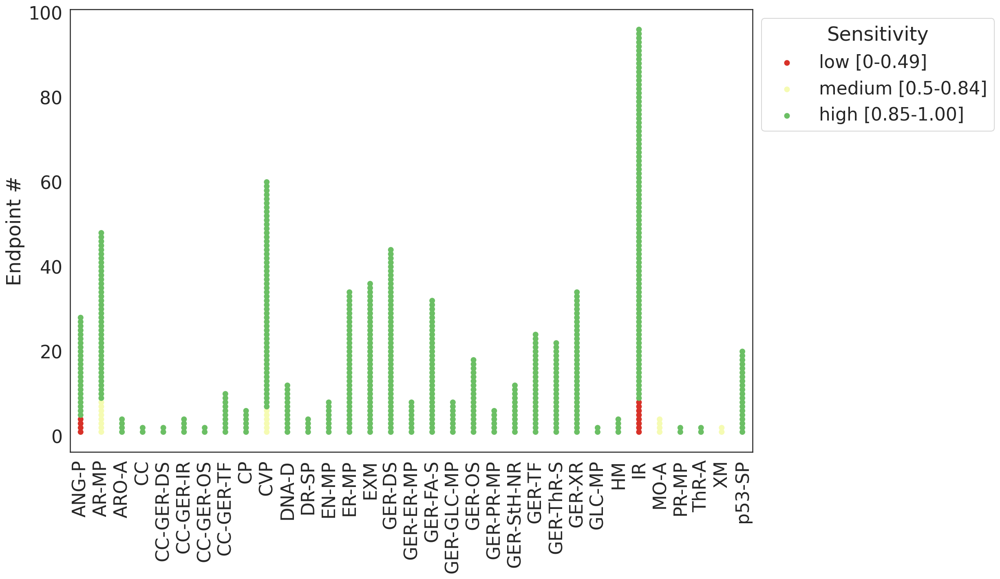

In [28]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      'font.size' : 22}
plt.rcParams.update(rc)
plt.figure(figsize=(13,10), dpi= 300)
sns.set_style("white")
palette3 = {"0.0-0.49":'#d83128',"0.5-0.84":"#f5fbb2", "0.85-1.0":"#6bbf64"}

df_wc_dot = df_wc.sort_values(by=['sensitivity'])
df_wc_dot = df_wc_dot.drop(df_wc_dot[df_wc_dot['mechT'] == "UNA"].index)

df_wc_dot['mechTT'] = df_wc_dot['mechT'].map(mechs_to_replace)

mechTT_count = []
#print(mechTT_count)

for index, mechTT in enumerate(df_wc_dot['mechTT']):
    subset = df_wc_dot.iloc[:index + 1] 
    count = len(subset[subset['mechTT'] == mechTT])
    mechTT_count.append(count) 
#print(mechTT_count)

df_wc_dot['sensitivity_discrete'] = pd.cut(df_wc_dot.sensitivity, bins=3, labels=['0.0-0.49', '0.5-0.84', '0.85-1.0'], right=False)
# Data for the plot
x = df_wc_dot['mechTT']
y = mechTT_count
hue = df_wc_dot['sensitivity_discrete']
sns.set_style("white")
# Dot plot created using scatter plot
plt.figure(figsize=(15, 10))
order = df_wc_dot.mechTT.sort_values().unique()
ax = sns.stripplot(x=x, y=y, hue=hue, s=7, legend="full", palette=palette3, order = order, jitter=False, edgecolor = "gray")
ax.set(xlabel='', ylabel='Endpoint #')
plt.xticks(rotation=90)
legend_labels, _= ax.get_legend_handles_labels()
ax.legend(legend_labels, ['low [0-0.49]','medium [0.5-0.84]','high [0.85-1.00]'], 
          bbox_to_anchor=(1,1), 
          title='Sensitivity')
plt.savefig('../plots/knime/dotplot_datafinal_endpointspermech_strip.svg', bbox_inches = 'tight', dpi = 300)
df_wc_dot.mechTT.sort_values().unique()

In [108]:
df_wc.groupby('mechT').count()

,sensitivity,specificity,precision,F,class,fps,model,subsampling,resampling,cyto,source,sampling_independent,accuracy,cohen,fps_class,mechanisticTargets
mechT,,,,,,,,,,,,,,,,
Androgen Met. Proc.,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48
Angiogenic Proc.,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28
Aromatase Act.,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4
CC-GER Dev. Sign.,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
CC-GER Inflammatory Resp.,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4
CC-GER Oxidative Stress,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
CC-GER Transcription Fact.,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10
Cell Cycle,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
Cell Viability Proc.,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60
